Face detection using **Haar cascades** is a machine learning based approach where a cascade function is trained with a set of input data. 
OpenCV already contains many pre-trained classifiers for face, eyes, smiles, etc.

Here we will use the face classifier.

### Importing OpenCV



In [0]:
import cv2

### Loading the cascade

In [0]:
face_cascade = cv2.CascadeClassifier('/content/drive/My Drive/Kaggle/haarcascade_frontalface_default.xml')

### Read the input image

In [0]:
img = cv2.imread('/content/drive/My Drive/Kaggle/My_Profile_Picture.jpg')

### Convert into grayscale
The detection works only on **grayscale** images. So it is important to convert the color image to grayscale.

In [0]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

### Detect faces
**detectMultiScale** function is used to detect the faces. 

It takes 3 arguments — the input image, scaleFactor and minNeighbours.  

*   **scaleFactor** specifies how much the image size is reduced at each image scale.

![alt text](https://www.bogotobogo.com/python/OpenCV_Python/images/FaceDetection/ImageScale.png)

This scale factor is used to create scale pyramid as shown in the picture. Suppose, the scale factor is 1.03, it means we're using a small step for resizing, i.e. reduce size by 3 %, we increase the chance of a matching size with the model for detection is found, while it's expensive.

*   **minNeighbours** specifies how many neighbors each candidate rectangle should have to retain it.

Parameter specifying how many neighbors each candidate rectangle should have to retain it. This parameter will affect the quality of the detected faces: higher value results in less detections but with higher quality. We're using 5 in the code.

Haar cascade classifier works with a sliding window approach. If you look at the cascade files you can see a size parameter which usually a pretty small value like 20 20. This is the smallest window that cascade can detect. So by applying a sliding window approach, you slide a window through out the picture than you resize it and search again until you can not resize it further. So with every iteration haar's cascaded classifier true outputs are stored. So when this window is slided in picture resized and slided again; it actually detects many many false positives. You can check what it detects by giving **minNeighbors 0**. So an example here :

![alt text](https://i.stack.imgur.com/qo2Xn.jpg)

So there are a lot of face detection because of resizing the sliding window and a lot of false positives too. So to eliminate false positives and get the proper face rectangle out of detections, neighborhood approach is applied. It is like if it is in neighborhood of other rectangles than it is ok, you can pass it further(You can see overlapping rectangkes only near the actual faces and not around the false positives). 

So this number determines the how much neighborhood is required to pass it as a face rectangle. In the same image when it is 1 :

![alt text](https://i.stack.imgur.com/AkJuA.jpg)

So by increasing this number you can eliminate false positives but be careful, by increasing it you can also lose true positives too. When it is 3 a perfect result :

![alt text](https://i.stack.imgur.com/QMPjD.jpg)

[StackOverflow - OpenCV detectMultiScale() minNeighbors parameter](https://stackoverflow.com/questions/22249579/opencv-detectmultiscale-minneighbors-parameter)



In [0]:
faces = face_cascade.detectMultiScale(gray, 1.1, 4)

### Draw rectangle around the faces

**faces** contains a list of coordinates for the rectangular regions where faces were found. 

We use these coordinates to draw the rectangles in our image.



```
cv2.rectangle(img, pt1, pt2, color, thickness, lineType, shift)
```

**Parameters**

*   **img**   Image.
*   **pt1**   Vertex of the rectangle.
*   **pt2**    Vertex of the rectangle opposite to pt1 .
*   **color** Rectangle color or brightness (grayscale image).
*   **thickness**  Thickness of lines that make up the rectangle. Negative values, like CV_FILLED , mean that the function has to draw a filled rectangle.


    
    


In [0]:
for (x, y, w, h) in faces:
    cv2.rectangle(img, (x, y), (x+w, y+h), (255, 0, 0), 2)

### Display the output

In [14]:
cv2.imshow('img', img)
cv2.waitKey()

# wait for ESC key to exit
if k == 27:   
    cv2.destroyAllWindows()
elif k == ord('s'):                   # wait for 's' key to save and exit
    cv2.imwrite('messigray.png',img)
    cv2.destroyAllWindows()

DisabledFunctionError: ignored

### Colab doesn't allow above syntax: Use that while on your machine
Import `cv2_imshow` from `google.colab.patches`



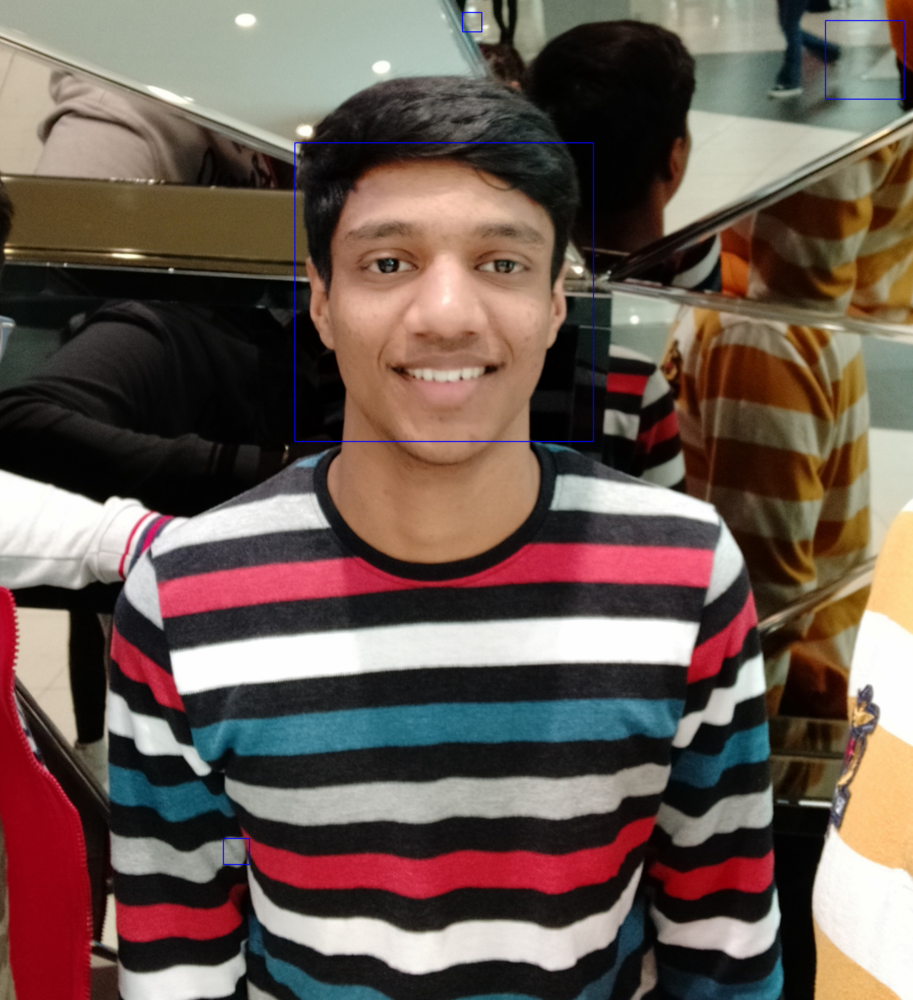

In [15]:
from google.colab.patches import cv2_imshow
cv2_imshow(img)

## Increasing the **minNeighbors** parameter might help remove unnecessary rectangles(False Positives) in the image

# Let's try on an image with more faces:

In [0]:
img2 = cv2.imread('/content/drive/My Drive/Kaggle/IMG_20191211_131805.jpg')

In [0]:
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

In [0]:
faces2 = face_cascade.detectMultiScale(gray2, 1.1, 10)

In [0]:
for (x, y, w, h) in faces2:
    cv2.rectangle(img2, (x, y), (x+w, y+h), (255, 0, 0), 2)

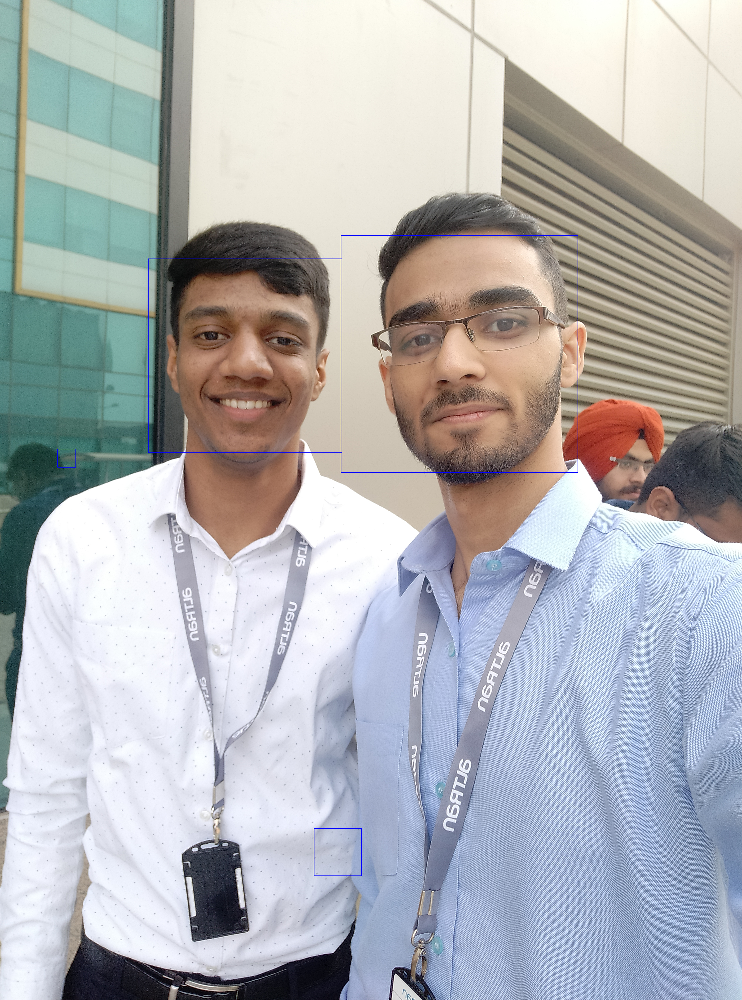

In [39]:
cv2_imshow(img2)

## Increasing the minNeighbors parameter helped decreasing unnecessary rectangles(False Positives) in the image